# CAM304

## REDES NEURAIS E APRENDIZAGEM EM PROFUNDIDADE

## Regressão Logística e Rede Neural

### Prof. Eduardo Luz / eduluz@ufop.edu.br

### Alunos:
###  Fernando Andrade da Silva

###  Jéssica Cristina Teireixa da Costa

###  Luiz Henrique Marcos Ferreira


Objetivos:

- *Overfitting*
- Regularização

Data da entrega : a ser definido

- Complete o código (marcado com ToDo) e quando requisitado, escreva textos diretamente nos notebooks. Onde tiver *None*, substitua pelo seu código.
- Crie um repositório no github para o grupo e me convide como colaborador (eduluzufop). Por fim, me envie o link do github.



# *Overfitting* e *Underfitting*

## Importando os pacotes e funções auxiliares


In [48]:
import numpy as np
import pathlib
import shutil
import tempfile

from  IPython import display
from matplotlib import pyplot as plt

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras import regularizers

from sklearn.metrics import classification_report

In [49]:
prop_cycle = plt.rcParams['axes.prop_cycle']
COLOR_CYCLE = prop_cycle.by_key()['color']

def _smooth(values, std):
  """Smooths a list of values by convolving with a Gaussian distribution.
  Assumes equal spacing.
  Args:
    values: A 1D array of values to smooth.
    std: The standard deviation of the Gaussian distribution. The units are
      array elements.
  Returns:
    The smoothed array.
  """
  width = std * 4
  x = np.linspace(-width, width, min(2 * width + 1, len(values)))
  kernel = np.exp(-(x / 5)**2)

  values = np.array(values)
  weights = np.ones_like(values)

  smoothed_values = np.convolve(values, kernel, mode='same')
  smoothed_weights = np.convolve(weights, kernel, mode='same')

  return smoothed_values / smoothed_weights

class HistoryPlotter(object):
  """A class for plotting a named set of Keras-histories.
  The class maintains colors for each key from plot to plot.
  """

  def __init__(self, metric=None, smoothing_std=None):
    self.color_table = {}
    self.metric = metric
    self.smoothing_std = smoothing_std

  def plot(self, histories, metric=None, smoothing_std=None):
    """Plots a {name: history} dictionary of Keras histories.
    Colors are assigned to the name-key, and maintained from call to call.
    Training metrics are shown as a solid line, validation metrics dashed.
    Args:
      histories: {name: history} a dictionary of Keras histories.
      metric: which metric to plot from all the histories.
      smoothing_std: the standard deviation of the smoothing kernel applied
        before plotting. The units are in array-indices.
    """
    if metric is None:
      metric = self.metric
    if smoothing_std is None:
      smoothing_std = self.smoothing_std

    for name, history in histories.items():
      # Remember name->color associations.
      if name in self.color_table:
        color = self.color_table[name]
      else:
        color = COLOR_CYCLE[len(self.color_table) % len(COLOR_CYCLE)]
        self.color_table[name] = color

      train_value = history.history[metric]
      val_value = history.history['val_' + metric]
      if smoothing_std is not None:
        train_value = _smooth(train_value, std=smoothing_std)
        val_value = _smooth(val_value, std=smoothing_std)

      plt.plot(
          history.epoch,
          train_value,
          color=color,
          label=name.title() + ' Train')
      plt.plot(
          history.epoch,
          val_value,
          '--',
          label=name.title() + ' Val',
          color=color)

    plt.xlabel('Epochs')
    plt.ylabel(metric.replace('_', ' ').title())
    plt.legend()

    plt.xlim(
        [0, max([history.epoch[-1] for name, history in histories.items()])])
    plt.grid(True)

class EpochDots(tf.keras.callbacks.Callback):
  """A simple callback that prints a "." every epoch, with occasional reports.
  Args:
    report_every: How many epochs between full reports
    dot_every: How many epochs between dots.
  """

  def __init__(self, report_every=100, dot_every=1):
    self.report_every = report_every
    self.dot_every = dot_every

  def on_epoch_end(self, epoch, logs):
    if epoch % self.report_every == 0:
      print()
      print('Epoch: {:d}, '.format(epoch), end='')
      for name, value in sorted(logs.items()):
        print('{}:{:0.4f}'.format(name, value), end=',  ')
      print()

    if epoch % self.dot_every == 0:
      print('.', end='', flush=True)


## Importando os dados e algumas constantes

Algumas constantes também podem ajudar:

In [50]:
FEATURES = 28 #'Quantidade' de características
BATCH_SIZE = 500 #Tamanho do lote de dados
N_VALIDATION = int(1e3)#Numero de amostras para validação
N_TRAIN = int(1e4)#Numero de amostras para treino

Iremos trabalhar com o conjunto de dados de Higgs. O objetivo não é fazer física de partículas ou se preocupar com detalhes do conjunto de dados. O importante de entender é que ele contém 11.000.000 amostras, cada um com 28 características (`FEATURES`) e um rótulo de classe binária.

In [51]:
gz = tf.keras.utils.get_file('HIGGS.csv.gz', 'http://mlphysics.ics.uci.edu/data/higgs/HIGGS.csv.gz')

A classe `tf.data.experimental.CsvDataset` pode ser usada para ler registros csv diretamente de um arquivo gzip sem etapa de descompactação intermediária.

In [52]:
ds = tf.data.experimental.CsvDataset(gz,[float(),]*(FEATURES+1), compression_type="GZIP")

Essa classe de leitor de csv retorna uma lista de escalares para cada registro. A função a seguir reempacota essa lista de escalares em um par (feature_vector, label).

O TensorFlow é mais eficiente ao operar em grandes lotes de dados. Portanto, em vez de reempacotar cada linha individualmente, criaremos um novo conjunto de Dataset que receba lotes de 10.000 exemplos, aplique a função `pack_row` a cada lote e, em seguida, divida os lotes em registros individuais:

In [53]:
def pack_row(*row):
  label = row[0]
  features = tf.stack(row[1:],1)
  return features, label

packed_ds = ds.batch(10000).map(pack_row).unbatch()

## Analisando os dados lidos

tf.Tensor(
[ 0.8692932  -0.6350818   0.22569026  0.32747006 -0.6899932   0.75420225
 -0.24857314 -1.0920639   0.          1.3749921  -0.6536742   0.9303491
  1.1074361   1.1389043  -1.5781983  -1.0469854   0.          0.65792954
 -0.01045457 -0.04576717  3.1019614   1.35376     0.9795631   0.97807616
  0.92000484  0.72165745  0.98875093  0.87667835], shape=(28,), dtype=float32)
tf.Tensor(1.0, shape=(), dtype=float32)


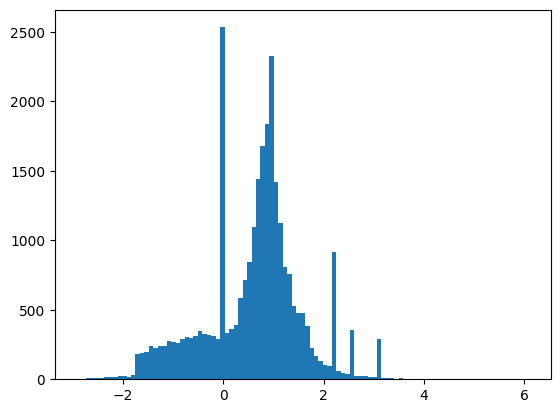

In [54]:
for features,label in packed_ds.batch(1000).take(1):
  print(features[0])
  print(label[0])
  plt.hist(features.numpy().flatten(), bins = 101)

11.000.000 de amostras é um número elevado de amostras para treino. Para essa prática, usaremos as 1.000 amostras para validação e as próximas 10.000 para treinamento.

Usaremos os métodos `Dataset.skip` e `Dataset.take` para facilitar esse processo.

In [55]:
validate_ds = packed_ds.take(N_VALIDATION).cache()
train_ds = packed_ds.skip(N_VALIDATION).take(N_TRAIN).cache()

## *Overfitting* (sobreajuste)

A maneira mais simples de evitar o *overfitting* é começar com um modelo pequeno: um modelo com um pequeno número de parâmetros (que é determinado pelo número de camadas e o número de unidades por camada). No aprendizado profundo, o número de parâmetros que podem ser aprendidos em um modelo é geralmente chamado de "capacidade" do modelo.

Intuitivamente, um modelo com mais parâmetros terá mais "capacidade de memorização" e, portanto, poderá aprender facilmente um mapeamento perfeito do tipo dicionário entre amostras de treinamento e seus alvos, um mapeamento sem nenhum poder de **generalização**, mas isso seria inútil ao fazer previsões em dados inéditos.

Sempre tenha isso em mente: os modelos de aprendizado profundo tendem a ser bons em se ajustar aos dados de treinamento, mas o verdadeiro desafio é a **generalização**, não o ajuste.

Por outro lado, se a rede tiver recursos de memorização limitados, ela não conseguirá aprender o mapeamento com tanta facilidade. Para minimizar sua perda, ele terá que aprender representações compactadas que tenham mais poder preditivo. Ao mesmo tempo, se você tornar seu modelo muito pequeno, ele terá dificuldade em se ajustar aos dados de treinamento. Há um equilíbrio entre "capacidade demais" e "capacidade de menos".

Infelizmente, não existe uma fórmula mágica para determinar o tamanho certo ou a arquitetura do seu modelo (em termos de número de camadas ou o tamanho certo para cada camada). Você terá que experimentar usando uma série de arquiteturas diferentes.

Para encontrar um tamanho de modelo apropriado, é melhor começar com relativamente poucas camadas e parâmetros e, em seguida, começar a aumentar o tamanho das camadas ou adicionar novas camadas até ver retornos decrescentes na perda de validação.

Comece com um modelo simples usando apenas `layers.Dense` como linha de base, depois crie versões maiores e compare-as.

## Configurando o treinamento de modelos

Nesta prática iremos avaliar diversos modelos. Para que a análise seja facilitada, usaremos a mesma configuração para todos os modelos.

- Muitos modelos treinam melhor se você reduzir gradualmente a taxa de aprendizado durante o treinamento. Uma forma de utilizar isso em TensorFlow é por meio dos `optimizers.schedules`, os quais variam a taxa de aprendizado ao longo do tempo. Nesta prática utilizaremos o `InverseTimeDecay`.
- Utilizaremos como base o otimizador `tf.keras.optimizers.Adam`, o qual usará o `InverseTimeDecay` para regular a taxa de aprendizado.

In [56]:
STEPS_PER_EPOCH = N_TRAIN // BATCH_SIZE # Total de amostras de treino / Batch size

lr_schedule = tf.keras.optimizers.schedules.InverseTimeDecay(
  0.001,
  decay_steps=STEPS_PER_EPOCH*1000,
  decay_rate=1,
  staircase=False)

def get_optimizer():
  return tf.keras.optimizers.Adam(lr_schedule)

O código acima define um `schedules.InverseTimeDecay` para diminuir hiperbolicamente a taxa de aprendizado para 1/2 da taxa básica em 1.000 épocas, 1/3 em 2.000 épocas e assim por diante.

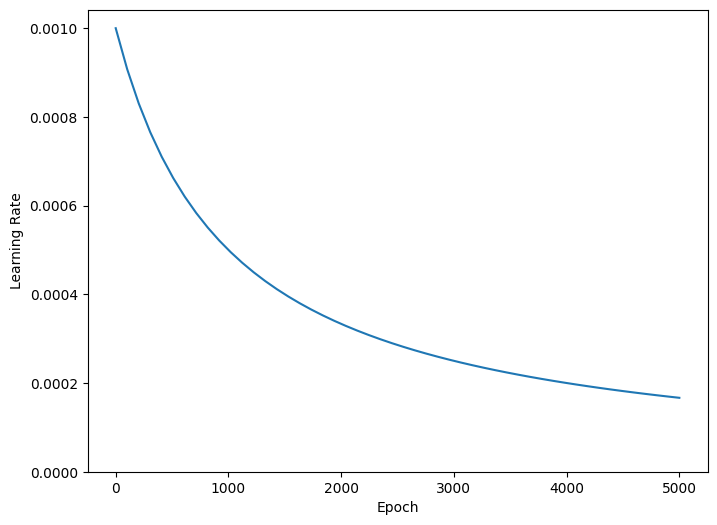

In [57]:
step = np.linspace(0,100000)
lr = lr_schedule(step)
plt.figure(figsize = (8,6))
plt.plot(step/STEPS_PER_EPOCH, lr)
plt.ylim([0,max(plt.ylim())])
plt.xlabel('Epoch')
_ = plt.ylabel('Learning Rate')

Outras Callbacks são necessárias:
- O treinamento para desta prática é executada por muitas épocas curtas. Para reduzir o ruído de log, use o `tfdocs.EpochDots` que simplesmente imprime `.` para cada época e um conjunto completo de métricas a cada 100 épocas.

- Para evitar tempos de treinamento longos e desnecessários, pode-se utilizar a `callbacks.EarlyStopping`. Observe que esse retorno de chamada é definido para monitorar o `val_binary_crossentropy` , não o `val_loss` . Essa diferença será importante mais tarde.
- Por fim, a `callbacks.TensorBoard` para gerar logs do TensorBoard para o treinamento.

In [58]:
logdir = pathlib.Path(tempfile.mkdtemp())/"tensorboard_logs"
shutil.rmtree(logdir, ignore_errors=True)

def get_callbacks(name):
  return [
    EpochDots(),
    tf.keras.callbacks.EarlyStopping(monitor='val_binary_crossentropy', patience=200),
    tf.keras.callbacks.TensorBoard(logdir/name),
  ]

Por fim, iremos definir uma função para treinar e compilar os modelos.

In [59]:
def compile_and_fit(model, name, max_epochs=10000):
  optimizer = get_optimizer()
  model.compile(optimizer=optimizer,
                loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
                metrics=[tf.keras.losses.BinaryCrossentropy(
                             from_logits=True,
                             name='binary_crossentropy'),
                         'accuracy'])

  model.summary()

  history = model.fit(
    train_ds,
    steps_per_epoch = STEPS_PER_EPOCH,
    epochs=max_epochs,
    validation_data=validate_ds,
    callbacks=get_callbacks(name),
    verbose=0)
  return history

## Treinando um modelo minúsculo

In [60]:
tiny_model = tf.keras.Sequential([
    layers.Dense(16, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(1)
])

Criando uma variável para guardar a história dos modelos treinados.

In [61]:
size_histories = {}

Treinando o nosso pequeno modelo.

In [62]:
validate_ds = validate_ds.batch(BATCH_SIZE)
train_ds = train_ds.shuffle(int(1e4)).repeat().batch(BATCH_SIZE)

size_histories['Tiny'] = compile_and_fit(tiny_model, 'sizes/Tiny')

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_28 (Dense)                     │ (None, 16)                  │             464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_29 (Dense)                     │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 481 (1.88 KB)

 Trainable params: 481 (1.88 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.4783,  binary_crossentropy:0.7900,  loss:0.7900,  val_accuracy:0.5090,  val_binary_crossentropy:0.7397,  val_loss:0.7397,  
....................................................................................................
Epoch: 100, accuracy:0.5968,  binary_crossentropy:0.6274,  loss:0.6274,  val_accuracy:0.5820,  val_binary_crossentropy:0.6276,  val_loss:0.6276,  
....................................................................................................
Epoch: 200, accuracy:0.6181,  binary_crossentropy:0.6168,  loss:0.6168,  val_accuracy:0.5830,  val_binary_crossentropy:0.6197,  val_loss:0.6197,  
....................................................................................................
Epoch: 300, accuracy:0.6353,  binary_crossentropy:0.6080,  loss:0.6080,  val_accuracy:0.6230,  val_binary_crossentropy:0.6069,  val_loss:0.6069,  
....................................................................................................
Epoch: 40

### Verificando o modelo

(0.5, 0.7)

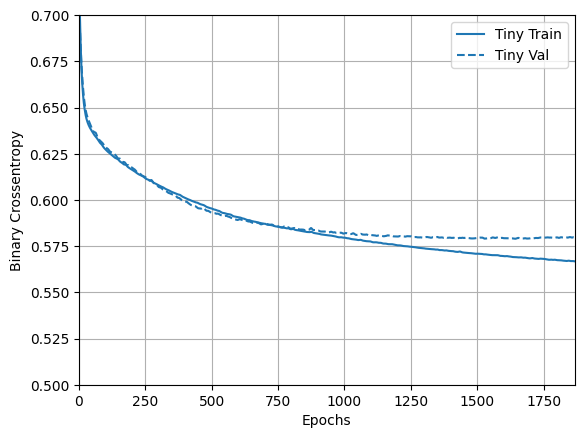

In [63]:
plotter = HistoryPlotter(metric = 'binary_crossentropy', smoothing_std=10)
plotter.plot(size_histories)
plt.ylim([0.5, 0.7])

As linhas sólidas mostram a `loss` de treinamento e as linhas tracejadas mostram a `loss` de validação (lembre-se: uma `loss` de validação menor indica um modelo melhor).

## Treinando um modelo pequeno

Uma forma de tentar superar o desempenho do modelo minúsculo é treinando progressivamente alguns modelos maiores.

No modelo minúsculo usamos somente uma camada de 16 neurônios. Vamos experimentar com duas camadas ocultas com 16 unidades.

In [64]:
small_model = tf.keras.Sequential([
    layers.Dense(16, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(16, activation='elu'),
    layers.Dense(1)
])

In [65]:
size_histories['Small'] = compile_and_fit(small_model, 'sizes/Small')

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_30 (Dense)                     │ (None, 16)                  │             464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_31 (Dense)                     │ (None, 16)                  │             272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_32 (Dense)                     │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 753 (2.94 KB)

 Trainable params: 753 (2.94 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5001,  binary_crossentropy:0.9284,  loss:0.9284,  val_accuracy:0.4670,  val_binary_crossentropy:0.8347,  val_loss:0.8347,  
....................................................................................................
Epoch: 100, accuracy:0.6257,  binary_crossentropy:0.6124,  loss:0.6124,  val_accuracy:0.5960,  val_binary_crossentropy:0.6159,  val_loss:0.6159,  
....................................................................................................
Epoch: 200, accuracy:0.6571,  binary_crossentropy:0.5894,  loss:0.5894,  val_accuracy:0.6310,  val_binary_crossentropy:0.5932,  val_loss:0.5932,  
....................................................................................................
Epoch: 300, accuracy:0.6736,  binary_crossentropy:0.5772,  loss:0.5772,  val_accuracy:0.6540,  val_binary_crossentropy:0.5871,  val_loss:0.5871,  
....................................................................................................
Epoch: 40

### Verificando ambos modelos treinados

(0.5, 0.7)

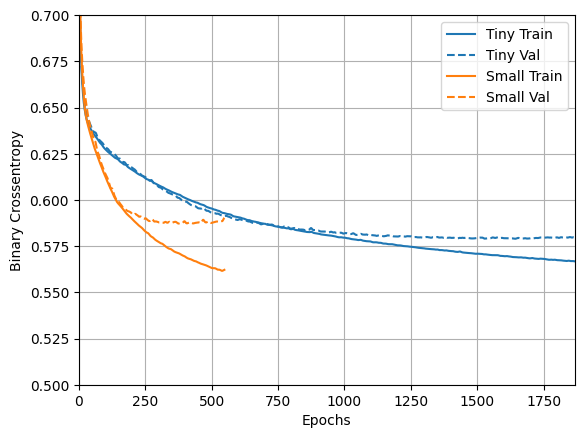

In [66]:
plotter = HistoryPlotter(metric = 'binary_crossentropy', smoothing_std=10)
plotter.plot(size_histories)
plt.ylim([0.5, 0.7])

## Treinando um modelo médio

Vamos tentar agora um modelo com 3 camadas e 64 neurônios por camada (quatro vezes mais).

In [67]:
medium_model = tf.keras.Sequential([
    layers.Dense(64, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(64, activation='elu'),
    layers.Dense(64, activation='elu'),
    layers.Dense(1)
])

In [68]:
size_histories['Medium']  = compile_and_fit(medium_model, "sizes/Medium")

Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_33 (Dense)                     │ (None, 64)                  │           1,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_34 (Dense)                     │ (None, 64)                  │           4,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_35 (Dense)                     │ (None, 64)                  │           4,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_36 (Dense)                     │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,241 (40.00 KB)

 Trainable params: 10,241 (40.00 KB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.4876,  binary_crossentropy:0.7020,  loss:0.7020,  val_accuracy:0.4730,  val_binary_crossentropy:0.6874,  val_loss:0.6874,  
....................................................................................................
Epoch: 100, accuracy:0.7145,  binary_crossentropy:0.5283,  loss:0.5283,  val_accuracy:0.6940,  val_binary_crossentropy:0.5817,  val_loss:0.5817,  
....................................................................................................
Epoch: 200, accuracy:0.7796,  binary_crossentropy:0.4352,  loss:0.4352,  val_accuracy:0.6540,  val_binary_crossentropy:0.6652,  val_loss:0.6652,  
..................................................................

### Verificando os modelos treinados

(0.3, 0.7)

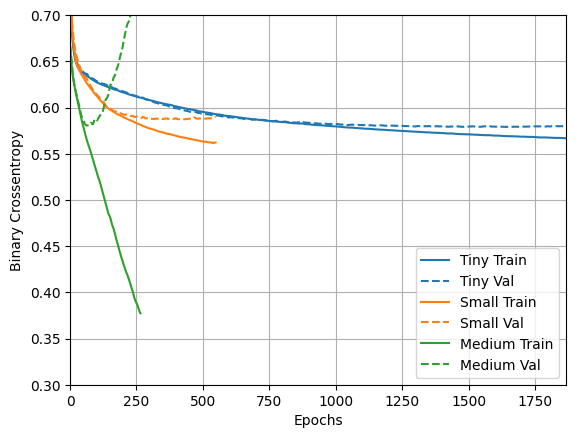

In [69]:
plotter.plot(size_histories)
plt.ylim([0.3, 0.7])

## Treinando um modelo grande

Você pode criar um modelo ainda maior e verificar a rapidez com que ele começa a fazer overfitting. O novo modelo possui mais camadas e mais neurônios por camada (512).

In [70]:
large_model = tf.keras.Sequential([
    layers.Dense(512, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(1)
])

In [71]:
size_histories['large'] = compile_and_fit(large_model, "sizes/large")

Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_37 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_38 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_39 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_40 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_41 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5088,  binary_crossentropy:0.8032,  loss:0.8032,  val_accuracy:0.4660,  val_binary_crossentropy:0.6973,  val_loss:0.6973,  
....................................................................................................
Epoch: 100, accuracy:1.0000,  binary_crossentropy:0.0020,  loss:0.0020,  val_accuracy:0.6680,  val_binary_crossentropy:1.8097,  val_loss:1.8097,  
....................................................................................................
Epoch: 200, accuracy:1.0000,  binary_crossentropy:0.0001,  loss:0.0001,  val_accuracy:0.6740,  val_binary_crossentropy:2.4456,  val_loss:2.4456,  
...............................

### Verificando os modelos treinados

Embora a construção de um modelo maior lhe dê mais poder, se esse poder não for restringido de alguma forma, ele pode facilmente se ajustar ao conjunto de treinamento.

Neste exemplo, normalmente, apenas o modelo minúsculo (`"Tiny"`) consegue evitar completamente o overfitting, e cada um dos modelos maiores superajusta os dados mais rapidamente. Isso se torna tão grave para o modelo grande (`"Large"`) que você precisa mudar o gráfico para uma escala logarítmica para realmente descobrir o que está acontecendo.

Isso fica aparente se você plotar e comparar as métricas de validação com as métricas de treinamento.

* É normal que haja uma pequena diferença.
* Se ambas as métricas estiverem se movendo na mesma direção, está tudo bem.
* Se a métrica de validação começar a estagnar enquanto a métrica de treinamento continua a melhorar, você provavelmente está perto do overfitting.
* Se a métrica de validação estiver indo na direção errada, o modelo está claramente superajustado.

Text(0.5, 0, 'Epochs [Log Scale]')

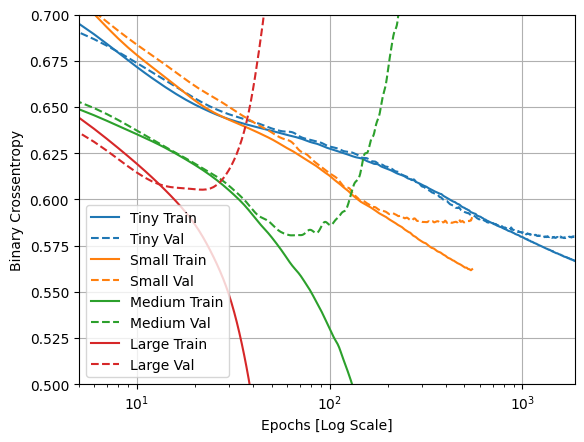

In [72]:
plotter.plot(size_histories)
a = plt.xscale('log')
plt.xlim([5, max(plt.xlim())])
plt.ylim([0.5, 0.7])
plt.xlabel("Epochs [Log Scale]")

Todas as execuções de treinamento acima usaram o `callbacks.EarlyStopping` para encerrar o treinamento, uma vez que ficou claro que o modelo não estava progredindo.

## **ToDo:** Avaliando um modelo gigante (10pt)

Adicione a esse *benchmark* uma rede que tenha muito mais capacidade, muito mais do que o problema precisa.

In [73]:
very_large_model = tf.keras.Sequential([
    layers.Dense(512, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(1)
])

In [74]:
size_histories['very_large'] = compile_and_fit(large_model, "sizes/very_large")

Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_37 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_38 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_39 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_40 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_41 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.9156,  binary_crossentropy:0.3862,  loss:0.3862,  val_accuracy:0.6410,  val_binary_crossentropy:2.8850,  val_loss:2.8850,  
....................................................................................................
Epoch: 100, accuracy:1.0000,  binary_crossentropy:0.0001,  loss:0.0001,  val_accuracy:0.6620,  val_binary_crossentropy:2.5450,  val_loss:2.5450,  
....................................................................................................
Epoch: 200, accuracy:1.0000,  binary_crossentropy:0.0000,  loss:0.0000,  val_accuracy:0.6680,  val_binary_crossentropy:2.7362,  val_loss:2.7362,  
...........

Text(0.5, 0, 'Epochs [Log Scale]')

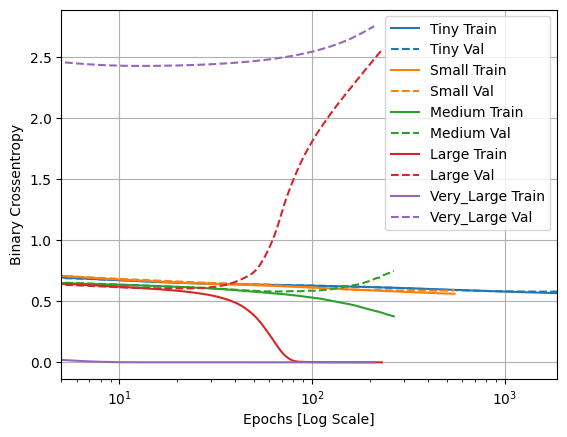

In [75]:
plotter.plot(size_histories)
a = plt.xscale('log')
plt.xlim([5, max(plt.xlim())])
plt.xlabel("Epochs [Log Scale]")

### **ToDo:** Avalie o seu modelo treinado conforme foi feito nos exemplos anteriores (10pt)

Resposta: ` O modelo proposto com muito mais capacidade que o problema precisa, nomeado "very_large", conta com 6 camadas de 512 neurônios e a camada de saída, apenas 2 camadas a mais que o modelo "large". O overfitting era esperado de ocorrer e, pelo gráfico resultante do treinamento do modelo, mesmo em escala logarítmica, pode se notar que as métricas divergem para direções opostas muito mais rapidamente, comparado aos demais treinamentos. Corroborando com um fato que já havia sido percebido no treinamento do modelo médio e grande: o tamanho do modelo não implica diretamente na qualidade da predição em dados inéditos. `


## Avaliando os resultados no *TensorBoard*

Salvamos os logs do TensorBoard durante o treinamento de todos os modelos treinados.

Podemos abrir um visualizador TensorBoard incorporado em um notebook.

In [76]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# Open an embedded TensorBoard viewer
%tensorboard --logdir {logdir}/sizes

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

### **ToDo:** Análises (10pt)

Quais análises você pode fazer sobre o TensorBoard?

Resposta:`O TensorBoard apresenta acurácia por época, entropia cruzada binária por época e "loss" por época tanto para dados de treinamento quanto de validação; taxa de aprendizado por época para o treinamento; avaliação da acuária por iteração, avaliação da entropia cruzada binária por iteração e avaliação da "loss" apenas nos dados de validação.`
- `Como a "loss" utilizada era a própria entropia cruzada binária, nota-se que os gráficos gerados são os mesmos. Como já visto nos gráficos traçados anteriormente, a entropia cruzada binária fornece uma ideia convergência dos modelos em relação a validação e treino, e o que pode-se notar é o aumento do overftting a medida que o tamanho do modelo também aumenta.`
- `No que diz respeito a acurária por época, nota-se que, nos modelos minúsculo e pequeno, a acurária converge para valores próximos tanto no treinamento quanto na validação, superior a 60%. Nos demais modelos, há uma acurácia elevada nos dados de treinamento, enquanto na validação a acurácia é mais baixa, o que indica que o modelo ficou superespecializado nos dados de treinamento, contudo, cabe destacar que, ainda sim, a acurária da validação nesses casos assumiu valores não muito distantes dos modelos pequeno e médio. Esse fato ilustra o desequilíbrio em relação a capacidade do modelo e o impacto do overfitting sentido por cada um. `
-`Outro fato facilmente notado é a duração em épocas de cada modelo é diferente. Como a monitoração era feita observando a "val_binary_crossentropy", e a cada aumento do modelo havia uma piora, então o treinamento dos maiores modelos parou mais cedo. `

# Estratégias para previnir *overfitting* (sobreajuste)

Antes de entrar no conteúdo desta seção, copie os logs de treinamento do modelo minúsculo (`"Tiny"`) acima, para usar como linha de base para comparação.

Iremos comparar os logs de treinamento do modelo minúsculo (`"Tiny"`) acima, por isso iremos copiar os logs.

In [77]:
shutil.rmtree(logdir/'regularizers/Tiny', ignore_errors=True)
shutil.copytree(logdir/'sizes/Tiny', logdir/'regularizers/Tiny')# Copia os logs de treinamento do Modelo Tiny

PosixPath('/tmp/tmpvmv50qvl/tensorboard_logs/regularizers/Tiny')

In [78]:
regularizer_histories = {}
regularizer_histories['Tiny'] = size_histories['Tiny']

### Adicionando estratégias de regularização ao modelo


Você pode estar familiarizado com o princípio da Navalha de Occam: dadas duas explicações para algo, a explicação mais provável de ser correta é a **mais simples**, aquela que faz a menor quantidade de suposições. Isso também se aplica aos modelos aprendidos pelas redes neurais: dados alguns dados de treinamento e uma arquitetura de rede, existem vários conjuntos de valores de pesos (múltiplos modelos) que podem explicar os dados, e modelos mais simples são menos propensos a sobreajustar do que os complexos.

Um "modelo simples" neste contexto é um modelo onde a distribuição de valores de parâmetros tem menos entropia (ou um modelo com menos parâmetros, como demonstrado na seção acima). Assim, uma maneira comum de mitigar o *overfitting* é colocar restrições na complexidade de uma rede, forçando seus pesos apenas a assumir valores pequenos, o que torna a distribuição de valores de peso mais "regular". Isso é chamado de "regularização de peso", e é feito adicionando à função de perda da rede um custo associado a ter grandes pesos. Este custo vem em dois sabores:

* [Regularização L1](https://developers.google.com/machine-learning/glossary/#L1_regularization), onde o custo adicionado é proporcional ao valor absoluto dos coeficientes dos pesos (ou seja, ao que é chamado de "norma L1 "dos pesos).

* [Regularização L2](https://developers.google.com/machine-learning/glossary/#L2_regularization), onde o custo adicionado é proporcional ao quadrado do valor dos coeficientes dos pesos (ou seja, ao que é chamado de quadrado "norma L2" dos pesos). A regularização L2 também é chamada de decaimento de peso no contexto de redes neurais. Não deixe que o nome diferente o confunda: a redução de peso (*weight decay*) é matematicamente igual à regularização L2.

A regularização L1 empurra os pesos para zero, incentivando um modelo esparso. A regularização de L2 penalizará os parâmetros de pesos sem torná-los esparsos, já que a penalidade vai para zero para pesos pequenos - uma razão pela qual L2 é mais comum.

Em `tf.keras`, a regularização de peso é adicionada passando instâncias do regularizador de peso para camadas como argumentos de palavras-chave. Adicione regularização de peso L2:

In [79]:
l2_model = tf.keras.Sequential([
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001), input_shape=(FEATURES,)),
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(512, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(1)
])

regularizer_histories['l2'] = compile_and_fit(l2_model, "regularizers/l2")

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_49 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_50 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_51 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_52 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_53 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5102,  binary_crossentropy:0.7626,  loss:2.2667,  val_accuracy:0.5000,  val_binary_crossentropy:0.6777,  val_loss:2.0903,  
..

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


..................................................................................................
Epoch: 100, accuracy:0.6544,  binary_crossentropy:0.5971,  loss:0.6191,  val_accuracy:0.6350,  val_binary_crossentropy:0.5882,  val_loss:0.6102,  
....................................................................................................
Epoch: 200, accuracy:0.6704,  binary_crossentropy:0.5829,  loss:0.6048,  val_accuracy:0.6460,  val_binary_crossentropy:0.5855,  val_loss:0.6070,  
....................................................................................................
Epoch: 300, accuracy:0.6765,  binary_crossentropy:0.5760,  loss:0.6024,  val_accuracy:0.6810,  val_binary_crossentropy:0.5781,  val_loss:0.6044,  
....................................................................................................
Epoch: 400, accuracy:0.6850,  binary_crossentropy:0.5667,  loss:0.5912,  val_accuracy:0.6820,  val_binary_crossentropy:0.5775,  val_loss:0.6020,  
..........

`l2(0,001)` significa que cada coeficiente na matriz de peso da camada adicionará `0,001 * weight_coeficiente_value**2` ao total de **perda** da rede.

É por isso que estamos monitorando o `binary_crossentropy` diretamente. Porque não tem esse componente de regularização misturado.

Então, esse mesmo modelo `"Large"` com uma penalidade de regularização `L2` tem um desempenho muito melhor:


(0.5, 0.7)

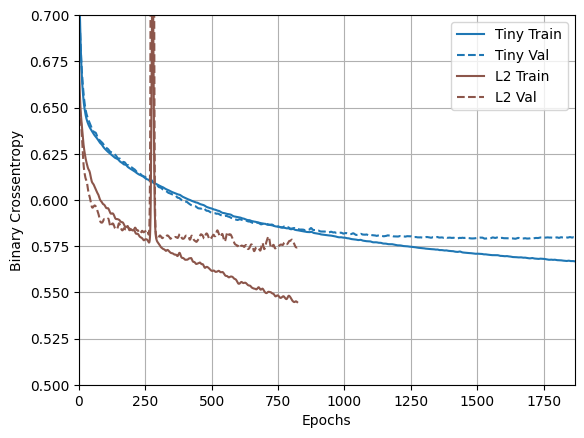

In [80]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

Conforme demonstrado, o modelo regularizado `"L2"` agora é muito mais competitivo com o modelo `"Tiny"`. Este modelo `"L2"` também é muito mais resistente ao overfitting do que o modelo `"Large"` no qual foi baseado, apesar de ter o mesmo número de parâmetros.

### Adicionando *dropout*

Dropout é uma das técnicas de regularização mais eficazes e mais utilizadas para redes neurais, desenvolvida por Hinton e seus alunos da Universidade de Toronto.

A explicação intuitiva para o dropout é que, como os nós individuais na rede não podem contar com a saída dos outros, cada nó deve produzir recursos que sejam úteis por conta própria.

O dropout, aplicado a uma camada, consiste em "descartar" aleatoriamente (ou seja, definir como zero) um número de recursos de saída da camada durante o treinamento. Por exemplo, uma determinada camada normalmente retornaria um vetor `[0.2, 0.5, 1.3, 0.8, 1.1]` para uma determinada amostra de entrada durante o treinamento; após aplicar dropout, este vetor terá algumas entradas zero distribuídas aleatoriamente, por exemplo. `[0, 0,5, 1,3, 0, 1,1]`.

A "taxa de abandono" é a fração dos recursos que estão sendo zerados; geralmente é definido entre 0,2 e 0,5. No momento do teste, nenhuma unidade é descartada e, em vez disso, os valores de saída da camada são reduzidos por um fator igual à taxa de abandono, de modo a equilibrar o fato de que mais unidades estão ativas do que no tempo de treinamento.

No Keras, você pode introduzir dropout em uma rede através da camada `tf.keras.layers.Dropout`, que é aplicada à saída da camada imediatamente anterior.

Adicione duas camadas de dropout à sua rede para verificar o desempenho delas na redução do overfitting:

In [81]:
dropout_model = tf.keras.Sequential([
    layers.Dense(512, activation='elu', input_shape=(FEATURES,)),
    layers.Dropout(0.5),#Dropout com taxa de abandono de 0.5 aplicada a camada acima
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dense(512, activation='elu'),
    layers.Dropout(0.5),#Dropout com taxa de abandono de 0.5 aplicada a camada acima
    layers.Dense(1)
])
#Dúvida: No enunciado, 2 camadas devem ser adicionadas, contudo no código não seriam 4?

regularizer_histories['dropout'] = compile_and_fit(dropout_model, "regularizers/dropout")

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_54 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_55 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_56 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_57 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_58 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5036,  binary_crossentropy:0.7669,  loss:0.7669,  val_accuracy:0.5220,  val_binary_crossentropy:0.7028,  val_loss:0.7028,  
....................................................................................................
Epoch: 100, accuracy:0.7074,  binary_crossentropy:0.5328,  loss:0.5328,  val_accuracy:0.6770,  val_binary_crossentropy:0.5839,  val_loss:0.5839,  
....................................................................................................
Epoch: 200, accuracy:0.9563,  binary_crossentropy:0.1116,  loss:0.1116,  val_accuracy:0.6770,  val_binary_crossentropy:1.3680,  val_loss:1.3680,  
..............................................................................

(0.5, 0.7)

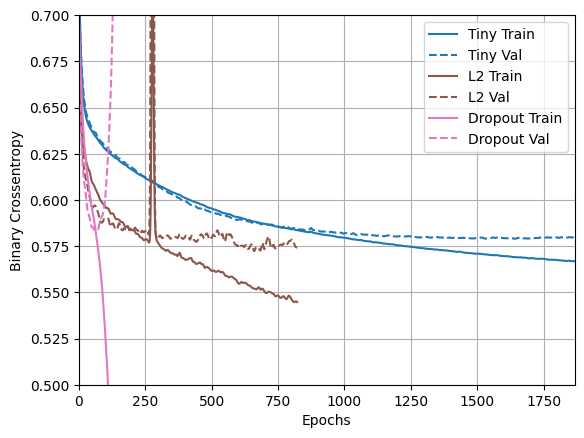

In [82]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

Fica claro neste gráfico que ambas as abordagens de regularização melhoram o comportamento do modelo grande (`"Large"`). Mas isso ainda não supera nem mesmo a linha de base `"Tiny"`.

Naturalmente, o próximo passo é testar os dois juntos.

### Combinando L2 + *dropout*

In [83]:
combined_model = tf.keras.Sequential([
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu', input_shape=(FEATURES,)),
    layers.Dropout(0.5),
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(512, kernel_regularizer=regularizers.l2(0.0001),
                 activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(1)
])

regularizer_histories['combined'] = compile_and_fit(combined_model, "regularizers/combined")

Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_59 (Dense)                     │ (None, 512)                 │          14,848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_60 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_61 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_62 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_63 (Dense)                     │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 803,329 (3.06 MB)

 Trainable params: 803,329 (3.06 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5023,  binary_crossentropy:0.8076,  loss:0.9660,  val_accuracy:0.5420,  val_binary_crossentropy:0.6821,  val_loss:0.8398,  
....................................................................................................
Epoch: 100, accuracy:0.6511,  binary_crossentropy:0.6082,  loss:0.6377,  val_accuracy:0.6710,  val_binary_crossentropy:0.5885,  val_loss:0.6177,  
....................................................................................................
Epoch: 200, accuracy:0.6598,  binary_crossentropy:0.5926,  loss:0.6169,  val_accuracy:0.6870,  val_binary_crossentropy:0.5727,  val_loss:0.5970,  
....................................................................................................
Epoch: 300, accuracy:0.6730,  binary_crossentropy:0.5824,  loss:0.6108,  val_accuracy:0.6810,  val_binary_crossentropy:0.5689,  val_loss:0.5973,  
....................................................................................................
Epoch: 40

(0.5, 0.7)

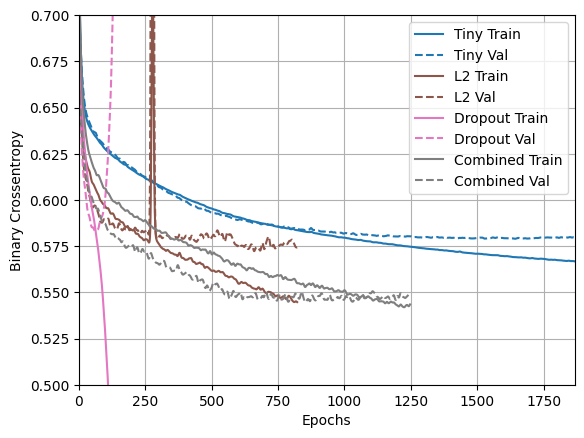

In [84]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

Este modelo com as regularizações combinadas (`"Combined"`) é obviamente o melhor até agora.

### Avaliando os resultados no *TensorBoard*


Esses modelos também registraram logs do TensorBoard.

Para abrir um visualizador de tensorboard incorporado em um notebook, copie o seguinte em uma célula de código:

```
%tensorboard --logdir {logdir}/regularizers
```

In [85]:
%tensorboard --logdir {logdir}/regularizers

<IPython.core.display.Javascript object>

#### **ToDo:** Análise dos resultados (10pt)

O que você pode inferir analisando os resultados apresentados no TensorBoard?

Resposta:` Pelos resultados apresentados pelo TensorBoard, com a regularização, alguns dos comportamentos notados em relação aos resultados anteriores são: o treino e validação do modelo grande agora convergem para a mesma direção, a convergência se dá de maneira mais lenta, o modelo grande agora regularizado é mais competitivo com o modelo "tiny". `

- `Apesar do fato de ainda haver o overfitting, com a inserção do dropout, nota-se que ele não ocorre na mesma velocidade que ocorreu no caso do modelo grande normal.`

- `A regularização L2 parece ter melhorado bastante a convergência do modelo nos dados de treino e validação para uma mesma direção, além de uma melhora também na acurácia.`

- `A combinação das duas estratégias criou um compromisso entre as duas características mencionadas e conseguiu tratar bem o overfitting, tornando o modelo grande bem interessante em relação ao minúsculo, situação que é bem discrepante em comparação a antes da regularização. `



# Avaliando estrátegias de *overfitting* e regularização para a base de gato/não-gato

Para essa próxima tarefa, avalie três modelos (semelhante ao que foi feito para a base de Higgs). Você deve treinar:
- Um modelo pequeno.
- Um modelo médio.
- Um modelo grande.

Criando uma variável para guardar a história dos modelos treinados.

In [125]:
cat_histories = {}

## **ToDo:** Lendo os dados da base de gatos/não-gatos (10pt)

In [126]:
import h5py
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [127]:

#Importando dados dos arquivos ".h5"
train_dataset = h5py.File('/content/drive/MyDrive/Colab Notebooks/train_catvnoncat.h5', "r")
train_set_features = np.array(train_dataset["train_set_x"][:]) # Treinamento: Conjunto de caracteristicas
train_set_labels = np.array(train_dataset["train_set_y"][:]) # Treinamento: Conjunto de classes

test_dataset = h5py.File('/content/drive/MyDrive/Colab Notebooks/test_catvnoncat.h5', "r")
test_set_features = np.array(test_dataset["test_set_x"][:]) # Teste: Conjunto de caracteristicas
test_set_labels = np.array(test_dataset["test_set_y"][:]) # test set labels

train_set_features = train_set_features/255.0 #Normalização dos dados de treinamento
test_set_features = test_set_features/255.0   #Normalização dos dados de teste

m_train = train_set_features.shape[0]
m_test = test_set_features.shape[0]
num_px = train_set_features.shape[1]

#Formato dos dados
print ("Dataset dimensions:")
print ("Number of training examples: m_train = " + str(m_train))
print ("Number of testing examples: m_test = " + str(m_test))
print ("Height/Width of each image: num_px = " + str(num_px))
print ("Each image is of size: (" + str(num_px) + ", " + str(num_px) + ", 3)")
print ("train_set_features shape: " + str(train_set_features.shape))
print ("train_set_labels shape: " + str(train_set_labels.shape))
print ("test_set_features shape: " + str(test_set_features.shape))
print ("test_set_labels shape: " + str(test_set_labels.shape))

Dataset dimensions:
Number of training examples: m_train = 209
Number of testing examples: m_test = 50
Height/Width of each image: num_px = 64
Each image is of size: (64, 64, 3)
train_set_features shape: (209, 64, 64, 3)
train_set_labels shape: (209,)
test_set_features shape: (50, 64, 64, 3)
test_set_labels shape: (50,)


1
[[[0.32156863 0.27843137 0.26666667]
  [0.34901961 0.3254902  0.3254902 ]
  [0.39215686 0.38431373 0.40784314]
  ...
  [0.51372549 0.51764706 0.5372549 ]
  [0.49411765 0.48627451 0.48627451]
  [0.41176471 0.38039216 0.37254902]]

 [[0.37254902 0.35686275 0.38039216]
  [0.40784314 0.40784314 0.44313725]
  [0.43137255 0.45098039 0.49411765]
  ...
  [0.52941176 0.5254902  0.52941176]
  [0.49803922 0.47843137 0.46666667]
  [0.43529412 0.41176471 0.40392157]]

 [[0.36862745 0.33333333 0.3254902 ]
  [0.38039216 0.34901961 0.35294118]
  [0.43137255 0.42745098 0.45098039]
  ...
  [0.53333333 0.5254902  0.51372549]
  [0.49803922 0.47058824 0.45882353]
  [0.45490196 0.42352941 0.40784314]]

 ...

 [[0.37647059 0.45490196 0.51372549]
  [0.38039216 0.45098039 0.50980392]
  [0.40392157 0.48235294 0.54509804]
  ...
  [0.59607843 0.60784314 0.61568627]
  [0.57254902 0.58431373 0.59607843]
  [0.50980392 0.52156863 0.5254902 ]]

 [[0.35294118 0.42352941 0.48235294]
  [0.36078431 0.42352941 0.4745098 

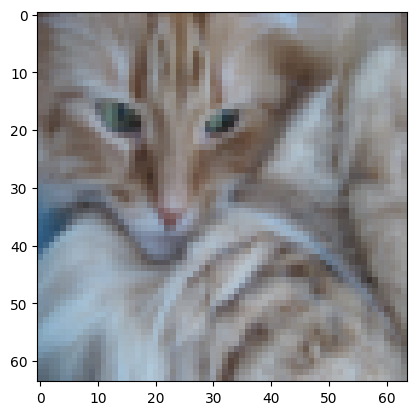

In [128]:
#Imprimindo dados
import matplotlib.pyplot as plt
plt.imshow(train_set_features[2])
print(train_set_labels[2])
print(train_set_features[2])

In [129]:
### Adaptações do código para base gato/não gato

# Alteração para reportar cada época
class EpochDots(tf.keras.callbacks.Callback):
  def __init__(self, report_every=5, dot_every=1):
    self.report_every = report_every
    self.dot_every = dot_every

  def on_epoch_end(self, epoch, logs):
    if epoch % self.report_every == 0:
      print()
      print('Epoch: {:d}, '.format(epoch), end='')
      for name, value in sorted(logs.items()):
        print('{}:{:0.4f}'.format(name, value), end=',  ')
      print()

    if epoch % self.dot_every == 0:
      print('.', end='', flush=True)

# Alteração do tamanho de lote e tamanho dos dados
BATCH_SIZE = 20
N_VALIDATION = m_test #Numero de amostras para validação
N_TRAIN = m_train     #Numero de amostras para treino
STEPS_PER_EPOCH = N_TRAIN // BATCH_SIZE # Divisão inteira: Total de amostras de treino/lote de dados
lr_schedule = tf.keras.optimizers.schedules.InverseTimeDecay(
  0.001,
  decay_steps=STEPS_PER_EPOCH*1000,
  decay_rate=1,
  staircase=False)

def get_optimizer():
  return tf.keras.optimizers.Adam(lr_schedule)

logdir = pathlib.Path(tempfile.mkdtemp())/"tensorboard_logs"
shutil.rmtree(logdir, ignore_errors=True)

def get_callbacks(name):
  return [
    EpochDots(),
    tf.keras.callbacks.EarlyStopping(monitor='val_binary_crossentropy', patience=30),
    #patience: Número de épocas sem melhora que o treinamento aceita até ser interrompido
    tf.keras.callbacks.TensorBoard(logdir/name),
  ]

def compile_and_fit(model, name, max_epochs):
  optimizer = get_optimizer()

  model.compile(optimizer=optimizer,
                loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
                metrics=[tf.keras.losses.BinaryCrossentropy(
                             from_logits=True,
                             name='binary_crossentropy'),
                         'accuracy'])

  model.summary()

  history = model.fit(
    x=train_set_features,
    y=train_set_labels,
    shuffle=False,
    epochs=max_epochs,
    validation_data=(test_set_features,test_set_labels),
    callbacks=get_callbacks(name),
    verbose=0)

  prediction=model.predict(test_set_features)# Predição para os dados de teste
  i=0
  while i<len(prediction):#Tornando o vetor de predição em binário
    if prediction[i]>=0.5:
      prediction[i]=1
    else:
      prediction[i]=0
    i=i+1

  return history,prediction #Histórico e Predição

## **ToDo:** Treinando um modelo pequeno (10pt)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_27 (Conv2D)                   │ (None, 62, 62, 16)          │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_27 (MaxPooling2D)      │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_12 (Flatten)                 │ (None, 15376)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_97 (Dense)                     │ (None, 32)                  │         492,064 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_98 (Dense)                     │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 492,545 (1.88 MB)

 Trainable params: 492,545 (1.88 MB)

 Non-trainable params: 0 (0.00 B)

/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/nn.py:681: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(



Epoch: 0, accuracy:0.5694,  binary_crossentropy:0.8143,  loss:0.8321,  val_accuracy:0.3400,  val_binary_crossentropy:1.2287,  val_loss:1.2926,  
.....
Epoch: 5, accuracy:0.8086,  binary_crossentropy:0.4034,  loss:0.4033,  val_accuracy:0.5400,  val_binary_crossentropy:0.6528,  val_loss:0.6671,  
.....
Epoch: 10, accuracy:0.8995,  binary_crossentropy:0.2727,  loss:0.2743,  val_accuracy:0.8400,  val_binary_crossentropy:0.4261,  val_loss:0.4310,  
.....
Epoch: 15, accuracy:0.9522,  binary_crossentropy:0.1879,  loss:0.1907,  val_accuracy:0.8200,  val_binary_crossentropy:0.3969,  val_loss:0.4041,  
.....
Epoch: 20, accuracy:0.9713,  binary_crossentropy:0.1295,  loss:0.1337,  val_accuracy:0.6600,  val_binary_crossentropy:0.6680,  val_loss:0.6868,  
.....
Epoch: 25, accuracy:0.9809,  binary_crossentropy:0.0938,  loss:0.0975,  val_accuracy:0.8000,  val_binary_crossentropy:0.4689,  val_loss:0.4948,  
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


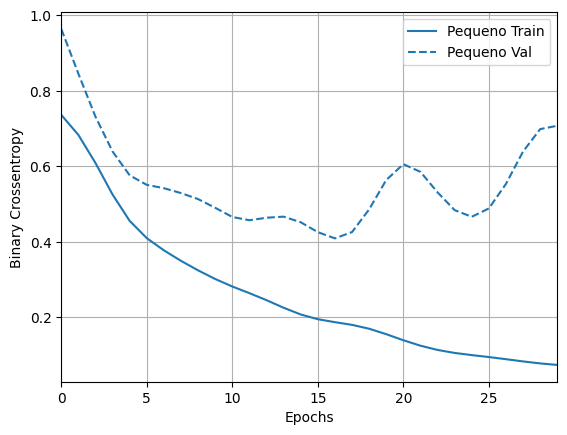

In [130]:
modelo_pequeno = tf.keras.Sequential([
  tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(64, 64, 3)),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(32, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])

(cat_histories['Pequeno'],predito_pequeno) = compile_and_fit(modelo_pequeno, 'catVncat/Pequeno', 30)
plotter = HistoryPlotter(metric = 'binary_crossentropy', smoothing_std=10)
plotter.plot(cat_histories)

## **ToDo:** Treinando um modelo médio (10pt)

Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)                   │ (None, 62, 62, 16)          │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_28 (MaxPooling2D)      │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_29 (Conv2D)                   │ (None, 29, 29, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_29 (MaxPooling2D)      │ (None, 14, 14, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_13 (Flatten)                 │ (None, 6272)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_99 (Dense)                     │ (None, 64)                  │         401,472 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_100 (Dense)                    │ (None, 128)                 │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_101 (Dense)                    │ (None, 1)                   │             129 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 415,009 (1.58 MB)

 Trainable params: 415,009 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.6411,  binary_crossentropy:0.6736,  loss:0.6810,  val_accuracy:0.3400,  val_binary_crossentropy:0.7529,  val_loss:0.7685,  
.....
Epoch: 5, accuracy:0.8278,  binary_crossentropy:0.3945,  loss:0.3990,  val_accuracy:0.7000,  val_binary_crossentropy:0.6009,  val_loss:0.6022,  
.....
Epoch: 10, accuracy:0.9139,  binary_crossentropy:0.2350,  loss:0.2437,  val_accuracy:0.7800,  val_binary_crossentropy:0.6273,  val_loss:0.6269,  
.....
Epoch: 15, accuracy:0.9713,  binary_crossentropy:0.0861,  loss:0.0904,  val_accuracy:0.8000,  val_binary_crossentropy:0.6322,  val_loss:0.6073,  
.....
Epoch: 20, accuracy:0.9713,  binary_crossentropy:0.0660,  loss:0.0690,  val_accuracy:0.8000,  val_binary_crossentropy:0.5898,  val_loss:0.5098,  
.....
Epoch: 25, accuracy:1.0000,  binary_crossentropy:0.0197,  loss:0.0207,  val_accuracy:0.8000,  val_binary_crossentropy:0.9121,  val_loss:0.9036,  
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


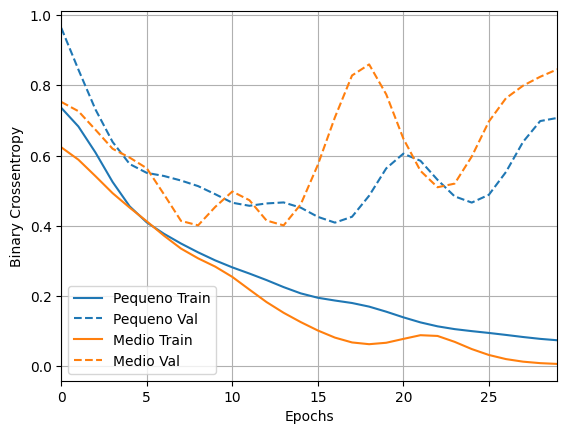

In [131]:
modelo_medio = tf.keras.Sequential([
  tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(64, 64, 3)),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])
(cat_histories['Medio'],predito_medio) = compile_and_fit(modelo_medio, 'catVncat/Medio',30)
plotter.plot(cat_histories)

## **ToDo:** Treinando um modelo grande (10pt)

Model: "sequential_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_30 (Conv2D)                   │ (None, 62, 62, 16)          │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_30 (MaxPooling2D)      │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_31 (Conv2D)                   │ (None, 29, 29, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_31 (MaxPooling2D)      │ (None, 14, 14, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_32 (Conv2D)                   │ (None, 12, 12, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_32 (MaxPooling2D)      │ (None, 6, 6, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_14 (Flatten)                 │ (None, 2304)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_102 (Dense)                    │ (None, 512)                 │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_103 (Dense)                    │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_104 (Dense)                    │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,466,913 (5.60 MB)

 Trainable params: 1,466,913 (5.60 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.6029,  binary_crossentropy:0.6568,  loss:0.6575,  val_accuracy:0.3400,  val_binary_crossentropy:0.7113,  val_loss:0.7174,  
.....
Epoch: 5, accuracy:0.8325,  binary_crossentropy:0.3936,  loss:0.4019,  val_accuracy:0.9000,  val_binary_crossentropy:0.4707,  val_loss:0.4453,  
.....
Epoch: 10, accuracy:0.9234,  binary_crossentropy:0.1764,  loss:0.1866,  val_accuracy:0.8000,  val_binary_crossentropy:0.6099,  val_loss:0.5538,  
.....
Epoch: 15, accuracy:0.9330,  binary_crossentropy:0.1614,  loss:0.1712,  val_accuracy:0.6600,  val_binary_crossentropy:0.9042,  val_loss:0.9043,  
.....
Epoch: 20, accuracy:0.9091,  binary_crossentropy:0.1478,  loss:0.1560,  val_accuracy:0.8600,  val_binary_crossentropy:0.5684,  val_loss:0.5098,  
.....
Epoch: 25, accuracy:1.0000,  binary_crossentropy:0.0051,  loss:0.0055,  val_accuracy:0.9000,  val_binary_crossentropy:0.9754,  val_loss:0.9358,  
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


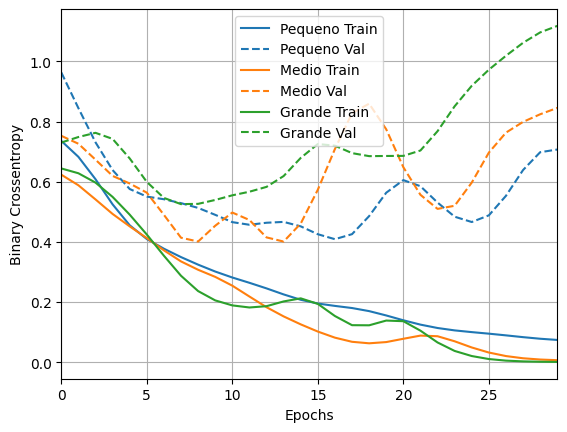

In [132]:
modelo_grande = tf.keras.Sequential([
  tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(64, 64, 3)),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])
(cat_histories['Grande'],predito_grande) = compile_and_fit(modelo_grande, 'catVncat/Grande',30)
plotter.plot(cat_histories)

## **ToDo:** Avalie a adição de regularização aos modelos (10pt)

Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_33 (Conv2D)                   │ (None, 62, 62, 16)          │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_33 (MaxPooling2D)      │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_18 (Dropout)                 │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_34 (Conv2D)                   │ (None, 29, 29, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_34 (MaxPooling2D)      │ (None, 14, 14, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_19 (Dropout)                 │ (None, 14, 14, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_35 (Conv2D)                   │ (None, 12, 12, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_35 (MaxPooling2D)      │ (None, 6, 6, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_20 (Dropout)                 │ (None, 6, 6, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_15 (Flatten)                 │ (None, 2304)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_105 (Dense)                    │ (None, 512)                 │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_21 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_106 (Dense)                    │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_107 (Dense)                    │ (None, 1)                   │             513 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,466,913 (5.60 MB)

 Trainable params: 1,466,913 (5.60 MB)

 Non-trainable params: 0 (0.00 B)


Epoch: 0, accuracy:0.5167,  binary_crossentropy:0.8193,  loss:0.9042,  val_accuracy:0.3400,  val_binary_crossentropy:0.6943,  val_loss:0.7841,  
.....
Epoch: 5, accuracy:0.6555,  binary_crossentropy:0.5731,  loss:0.6620,  val_accuracy:0.3400,  val_binary_crossentropy:0.6896,  val_loss:0.7812,  
.....
Epoch: 10, accuracy:0.7081,  binary_crossentropy:0.4696,  loss:0.5506,  val_accuracy:0.7600,  val_binary_crossentropy:0.6442,  val_loss:0.7162,  
.....
Epoch: 15, accuracy:0.8134,  binary_crossentropy:0.4014,  loss:0.4708,  val_accuracy:0.8400,  val_binary_crossentropy:0.6249,  val_loss:0.6505,  
.....
Epoch: 20, accuracy:0.8325,  binary_crossentropy:0.3515,  loss:0.4221,  val_accuracy:0.8600,  val_binary_crossentropy:0.5778,  val_loss:0.5891,  
.....
Epoch: 25, accuracy:0.8900,  binary_crossentropy:0.2422,  loss:0.3064,  val_accuracy:0.8800,  val_binary_crossentropy:0.5485,  val_loss:0.5463,  
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


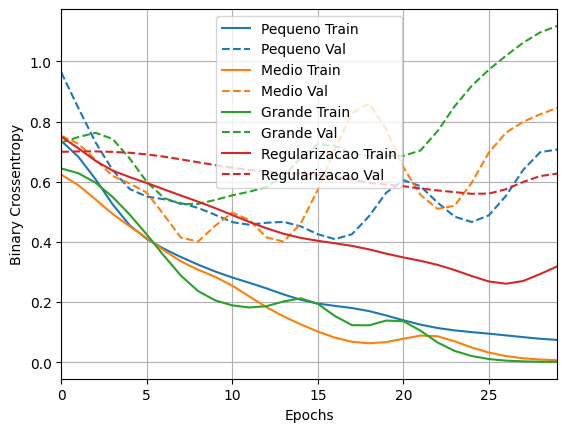

In [133]:
#Dúvida: A regularização pode não fazer sentido para modelos pequenos/médios
# Perguntar ao professor se ele queria que fossem testados todos os modelos, ou apenas o grande
modelo_com_regularizacao = tf.keras.Sequential([
  tf.keras.layers.Conv2D(16, (3,3), kernel_regularizer=regularizers.l2(0.0001), activation='relu', input_shape=(64, 64, 3)),
  tf.keras.layers.MaxPooling2D(2, 2),
  layers.Dropout(0.5),
  tf.keras.layers.Conv2D(32, (3,3),kernel_regularizer=regularizers.l2(0.0001), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  layers.Dropout(0.5),
  tf.keras.layers.Conv2D(64, (3,3),kernel_regularizer=regularizers.l2(0.0001), activation='relu'),
  tf.keras.layers.MaxPooling2D(2, 2),
  layers.Dropout(0.5),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(512,kernel_regularizer=regularizers.l2(0.0001), activation='relu'),
  layers.Dropout(0.5),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dense(1, activation='sigmoid')
])
(cat_histories['Regularizacao'],predito_regularizado) = compile_and_fit(modelo_com_regularizacao, 'catVncat/Regularizacao',30)
plotter.plot(cat_histories)

## Resultados do treinamento

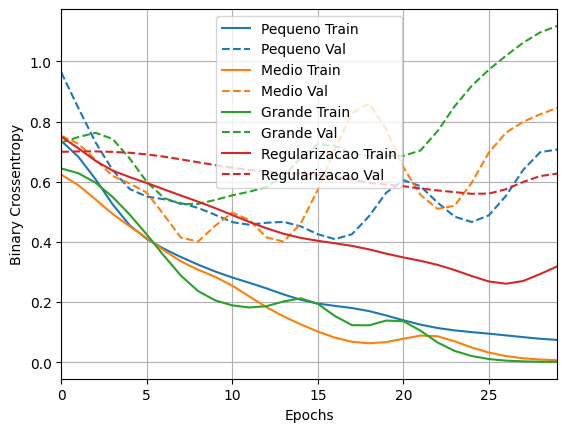

In [134]:
plotter.plot(cat_histories)

`De maneira semelhante ao que aconteceu na base de dados Higgs, na base de dados Gato/Não-Gato, a utilização de técnicas de regularização como a L2 e o Dropout tornaram o modelo grande, que apresentava bastante overfitting, num modelo que compete bem com o modelo pequeno.`

## **ToDo:** Análise dos resultados (10pt)

Avalia os modelos treinados quanto a Acurácia, F1-score, Precisão e revocação.

Dica: utilize a função [`classification_report`](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html) da sklearn.

- `Acurácia: reflete a quantidade de acertos do nosso modelo divido pelo total da amostra.`
- `Precisão: é a capacidade do classificador de não rotular uma amostra negativa como positivo.`
- `Recall: reflete a porcentagem de dados classificados como positivos comparado com a quantidade real de positivos que existem em nossa amostra.`
- `F1-score: essa métrica une precisão e recall afim de trazer um número único que determine a qualidade geral do nosso modelo.`

In [135]:
#Verificando o Modelo Pequeno
print(classification_report(test_set_labels, predito_pequeno,  target_names=['não-gato','gato']))

              precision    recall  f1-score   support

    não-gato       0.56      0.88      0.68        17
        gato       0.91      0.64      0.75        33

    accuracy                           0.72        50
   macro avg       0.73      0.76      0.72        50
weighted avg       0.79      0.72      0.73        50



In [136]:
#Verificando o Modelo Médio
print(classification_report(test_set_labels, predito_medio,  target_names=['não-gato','gato']))

              precision    recall  f1-score   support

    não-gato       0.62      0.88      0.73        17
        gato       0.92      0.73      0.81        33

    accuracy                           0.78        50
   macro avg       0.77      0.80      0.77        50
weighted avg       0.82      0.78      0.79        50



In [137]:
#Verificando o Modelo Grande
print(classification_report(test_set_labels, predito_grande,  target_names=['não-gato','gato']))

              precision    recall  f1-score   support

    não-gato       0.82      0.82      0.82        17
        gato       0.91      0.91      0.91        33

    accuracy                           0.88        50
   macro avg       0.87      0.87      0.87        50
weighted avg       0.88      0.88      0.88        50



In [138]:
#Verificando o Modelo Grande Regularizado
print(classification_report(test_set_labels, predito_regularizado,  target_names=['não-gato','gato']))

              precision    recall  f1-score   support

    não-gato       0.80      0.71      0.75        17
        gato       0.86      0.91      0.88        33

    accuracy                           0.84        50
   macro avg       0.83      0.81      0.82        50
weighted avg       0.84      0.84      0.84        50



O que você pode inferir analisando os resultados dos treinamentos para a base de gatos/não-gatos.

`Pelo comportamento apresentado nos gráficos nota-se que o overfitting ocorre a medida que o modelo aumenta, exceto no caso da regularização. Tinha-se em mente que as métricas apresentadas oferecessem resultados melhores nos modelos pequeno e regularizado, e piores para os modelos médio e grande, contudo, como se pode notar, não foi exatamente isso que aconteceu: `

- ` O modelo grande aprensentou as melhores acurácia e precisão, assim como recall e f1-score. O modelo médio  e regularizado apresentaram valores próximos, com o regularizado se sobressaindo. Por último, o modelo pequeno apresentou métricas inferiores aos demais.`

`O fato que aconteceu na base de dados gato/não-gato é provavelmente um problema em relação a capacidade dos modelos e ao tamanho da base de dados. Com uma base de dados pequena, é mais fácil o acontecimento do overfitting, principalmente para os maiores modelos, por isso o modelo pequeno apresentou pouco overfitting, mas isso não quer dizer que ele terá a capacidade de mapeamento dos dados necessária para fazer uma boa classificação. Assim sendo, pode-se dizer que o modelo pequeno tinha um tamanho bom para escapar do overfitting, mas também insuficiente para aprender as características da base de dados. Pode-se pensar de maneira parecida para o modelo grande, cujo tamanho era propício ao surgimento do overfitting, mas era o suficiente para aprender as características da base de dados. `